## Advanced Lane Finding Project

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

---
## First, I'll compute the camera calibration using chessboard images

In [55]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

In [56]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

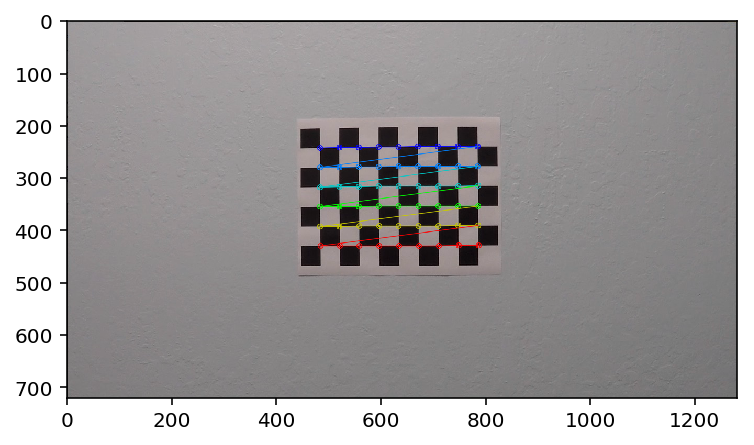

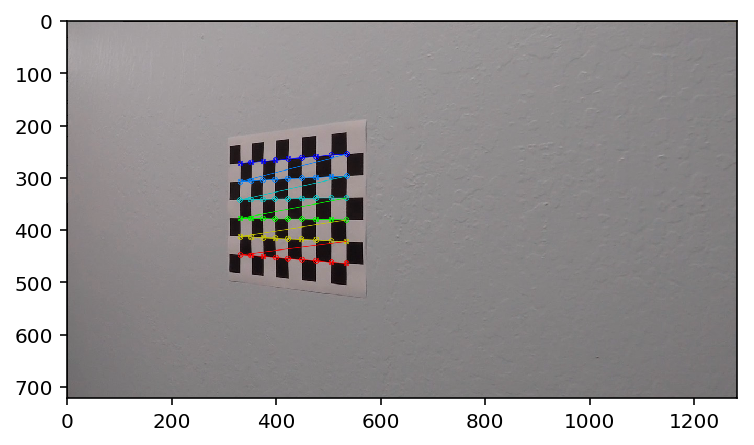

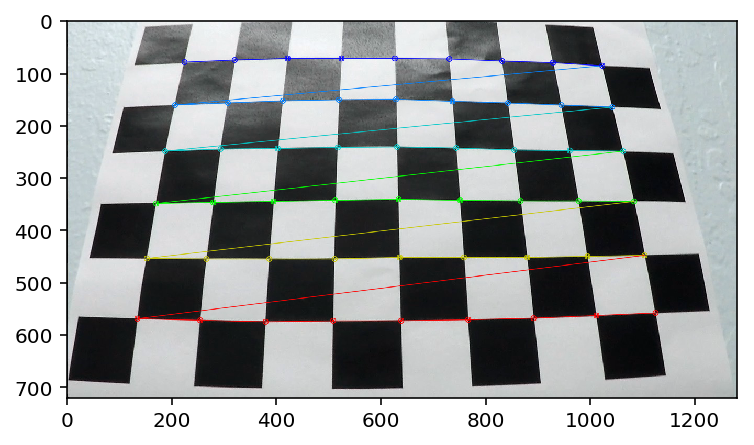

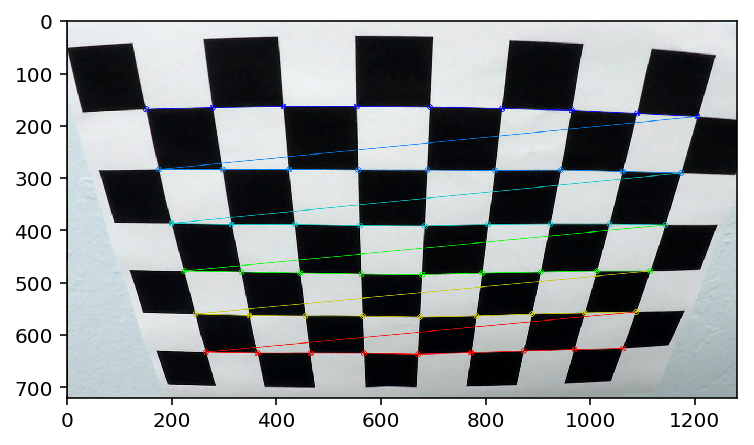

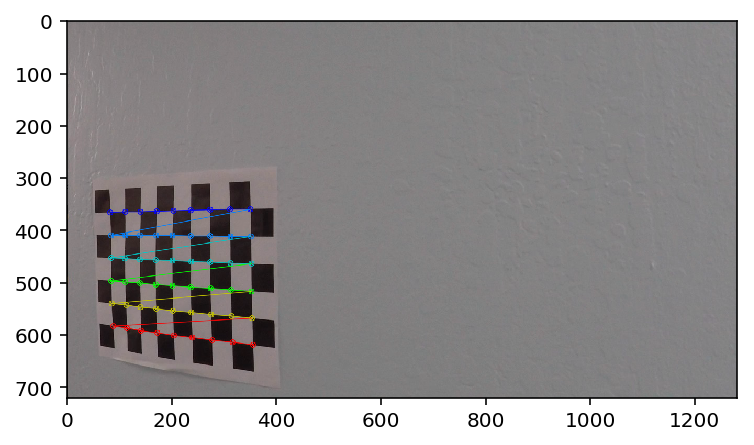

...

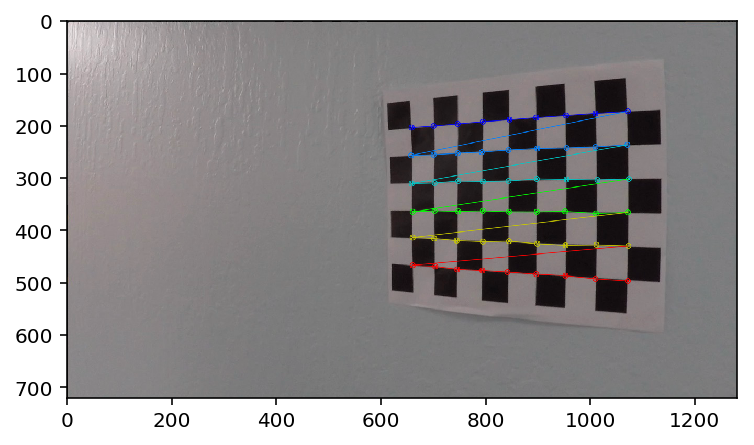

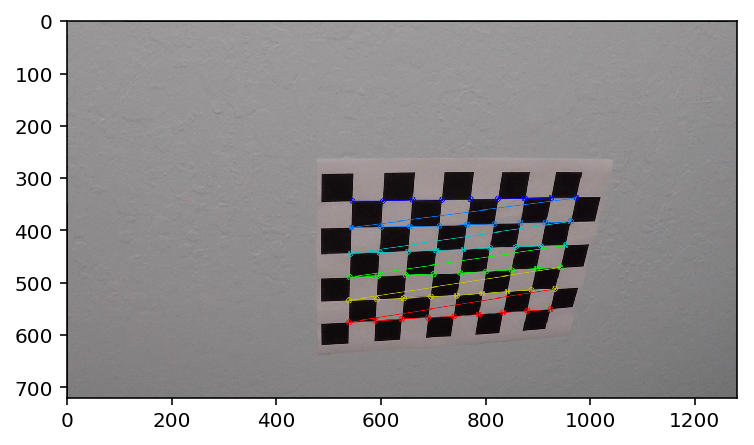

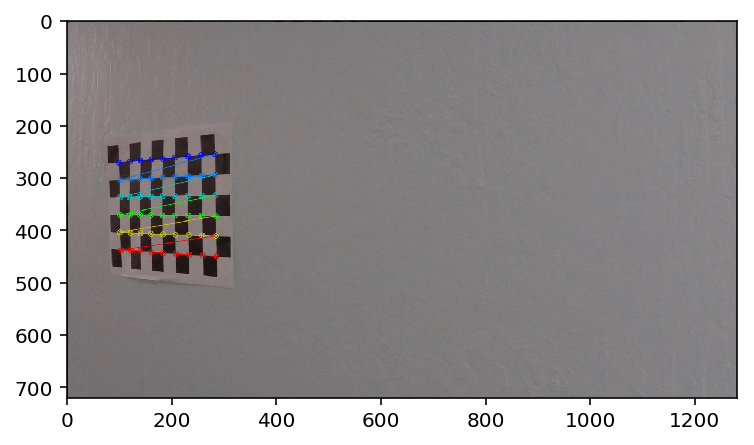

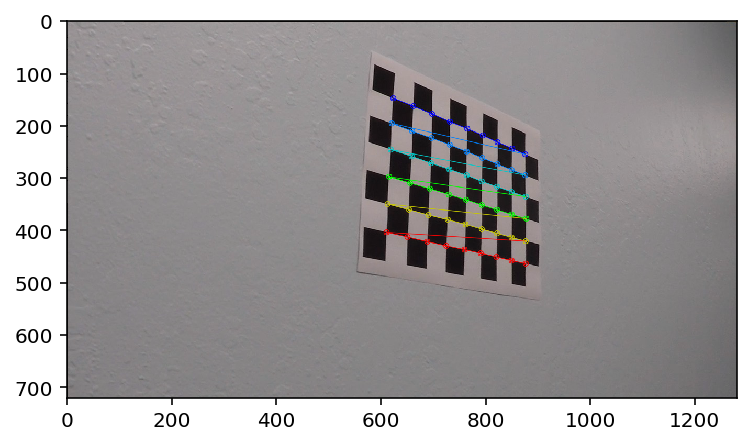

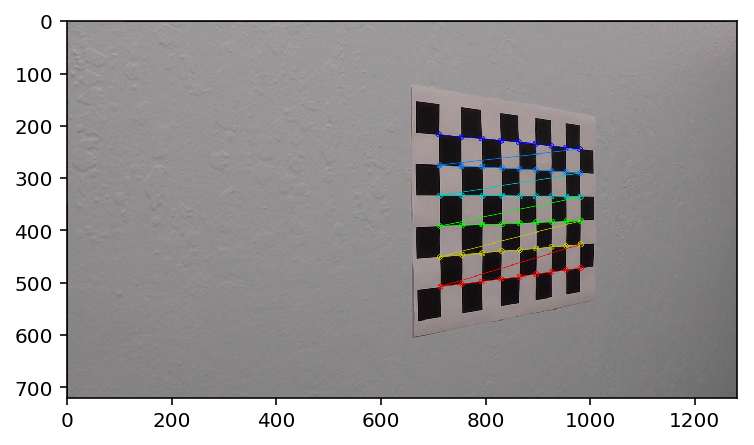

In [57]:
# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9, 0:6].T.reshape(-1, 2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('camera_cal/calibration*.jpg')

# Step through the list and search for chessboard corners
for fname in images:
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (9, 6), None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

        # Draw and display the corners
        img = cv2.drawChessboardCorners(img, (9,6), corners, ret)
        plt.imshow(img)
        plt.show()

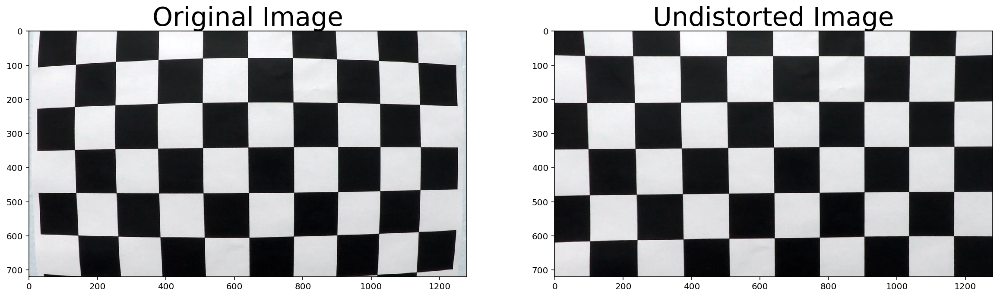

In [84]:
import pickle

# Test undistortion on an image
img = cv2.imread('camera_cal/calibration1.jpg')
img_size = (img.shape[1], img.shape[0])

camera_wide_dist_file = "camera_cal/wide_dist_pickle.p"

# Do camera calibration given object points and image points
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size, None, None)

dst = cv2.undistort(img, mtx, dist, None, mtx)

# Save the camera calibration result for later use (we won't worry about rvecs / tvecs)
dist_pickle = {}
dist_pickle["mtx"] = mtx
dist_pickle["dist"] = dist
#dst = cv2.cvtColor(dst, cv2.COLOR_BGR2RGB)
# Visualize undistortion
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=30)
ax2.imshow(dst)
ax2.set_title('Undistorted Image', fontsize=30)
plt.show()

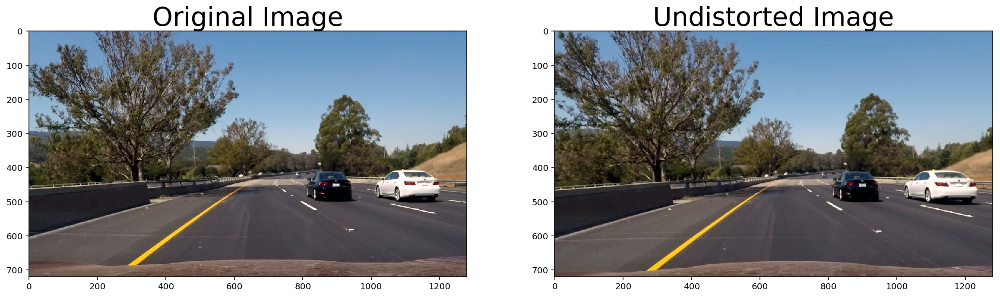

In [83]:
# Treatment effect
import matplotlib.image as mpimg

undistort_test = mpimg.imread('test_images/test6.jpg')
undistort_dst = cv2.undistort(undistort_test, mtx, dist, None, mtx)
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
ax1.imshow(undistort_test)
ax1.set_title('Original Image', fontsize=30)
ax2.imshow(undistort_dst)
ax2.set_title('Undistorted Image', fontsize=30)
plt.show()

## Image warpperspectiv

Text(0.5,1,'Warped Image')

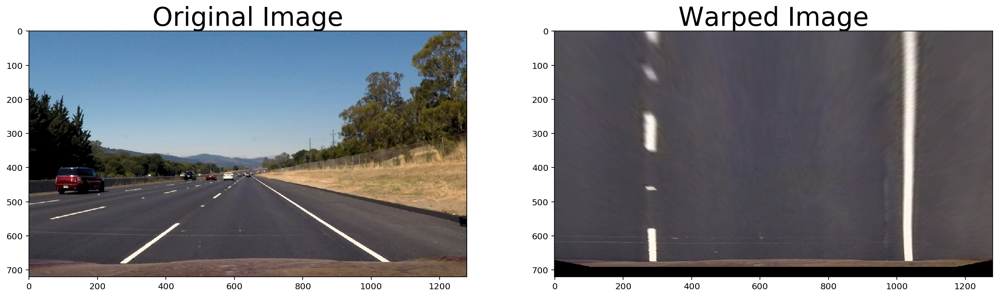

In [60]:
src = np.float32(
    [[(img_size[0] / 2) - 55, img_size[1] / 2 + 100],
    [((img_size[0] / 6) - 10), img_size[1]],
    [(img_size[0] * 5 / 6) + 60, img_size[1]],
    [(img_size[0] / 2 + 55), img_size[1] / 2 + 100]])
dst = np.float32(
    [[(img_size[0] / 4), 0],
    [(img_size[0] / 4), img_size[1]],
    [(img_size[0] * 3 / 4), img_size[1]],
    [(img_size[0] * 3 / 4), 0]])
M = cv2.getPerspectiveTransform(src_points, dst_points)
Minv = cv2.getPerspectiveTransform(dst_points, src_points)
dist_pickle['M'] = M
dist_pickle['Minv'] = Minv
pickle.dump(dist_pickle, open(camera_wide_dist_file, "wb" ))

straight_line = 'test_images/straight_lines2.jpg'
straight_img = mpimg.imread(straight_line)
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
ax1.imshow(straight_img)
ax1.set_title('Original Image', fontsize=30)
ax2.imshow(cv2.warpPerspective(straight_img, M, (1280, 720)))
ax2.set_title('Warped Image', fontsize=30)

# Save point, can starts with this line

In [2]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

import pickle
import cv2
import glob
import numpy as np
import matplotlib.pyplot as plt

camera_wide_dist_file = "camera_cal/wide_dist_pickle.p"

In [3]:
class PipleLine(object):
    def __init__(self, undistort_pickle_file):
        self.undistort_pickle_file = undistort_pickle_file
        self.mtx, self.dist, self.M, self.Minv = self.load_undistort_pickle(self.undistort_pickle_file)
    
    @staticmethod
    def load_undistort_pickle(undistort_pickle_file):
         # Load coefficient of Correcting for Distortion and coefficient of Perspective Transform
        data = pickle.load(open(undistort_pickle_file, 'rb'))
        return data['mtx'], data['dist'], data['M'], data['Minv']
    
    def undistort_img(self, img):
        # Correcting for Distortion
        return cv2.undistort(img, self.mtx, self.dist, None, self.mtx)
    
    def warpperspectiv_img(self, img):
        # Perspective Transform
        undistort = self.undistort_img(img)
        return cv2.warpPerspective(undistort, self.M, undistort.shape[1::-1])
    
    def unwarpperspectiv_img(self, warped_img):
        return cv2.warpPerspective(warped_img, self.Minv, warped_img.shape[1::-1])

pipline = PipleLine(camera_wide_dist_file)

In [4]:
class ImageThresh(object):
    def __init__(self, s_thresh=(170, 255), r_thresh=(200, 255), x_thresh=(20, 100), y_thresh=(20, 100),
                 m_thresh=(30, 100), d_thresh=(0.7, 1.3), h_thresh=(15, 100), l_thresh=(225, 255),
                 v_thresh=(90, 255), b_thresh=(155, 200)):
        self.s_thresh = s_thresh
        self.r_thresh = r_thresh
        self.x_thresh = x_thresh
        self.y_thresh = y_thresh
        self.m_thresh = m_thresh
        self.d_thresh = d_thresh
        self.h_thresh = h_thresh
        self.l_thresh = l_thresh
        self.v_thresh = v_thresh
        self.b_thresh = b_thresh

    @staticmethod
    def binary_output(gray_img, abs_sobel, thresh):
        scale_factor = np.max(abs_sobel) / 255
        scaled_sobel = (abs_sobel / scale_factor).astype(np.uint8)
        binary_output = np.zeros_like(gray_img)
        binary_output[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1
        return binary_output

    def abs_sobel_thresh(self, warped_img, orient='x', sobel_kernel=3):
        gray = cv2.cvtColor(warped_img, cv2.COLOR_RGB2GRAY)
        if orient == 'x':
            abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel))
            thresh = self.x_thresh
        elif orient == 'y':
            abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel))
            thresh = self.y_thresh
        else:
            raise ValueError('orient must be "x" or "y"')
        return self.binary_output(gray, abs_sobel, thresh)

    def mag_thresh(self, warped_img, sobel_kernel=3):
        gray = cv2.cvtColor(warped_img, cv2.COLOR_RGB2GRAY)
        sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
        sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
        sobelxy = np.sqrt(sobelx ** 2 + sobely ** 2)
        return self.binary_output(gray, sobelxy, self.m_thresh)

    def dir_threshold(self, warped_img, sobel_kernel=3):
        gray = cv2.cvtColor(warped_img, cv2.COLOR_RGB2GRAY)
        sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
        sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
        arcsobel = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
        binary_output = np.zeros_like(gray)
        binary_output[(arcsobel > self.d_thresh[0]) & (arcsobel < self.d_thresh[1])] = 1
        return binary_output

    def combined_sobel(self, warped_img, sobel_kernel=3):
        gradx = self.abs_sobel_thresh(warped_img, orient='x', sobel_kernel=sobel_kernel)
        grady = self.abs_sobel_thresh(warped_img, orient='y', sobel_kernel=sobel_kernel)
        mag_binary = self.mag_thresh(warped_img, sobel_kernel=sobel_kernel)
        dir_binary = self.dir_threshold(warped_img, sobel_kernel=sobel_kernel)

        combin = np.zeros((warped_img.shape[0], warped_img.shape[1]))
        combin[((gradx == 1) & (grady == 1)) | ((mag_binary == 1) & (dir_binary == 1))] = 1
        return combin

    @staticmethod
    def ret_binary(channel, thresh):
        binary = np.zeros_like(channel)
        binary[(channel > thresh[0]) & (channel <= thresh[1])] = 1
        return binary

    def h_threshhold(self, warped_img):
        hls = cv2.cvtColor(warped_img, cv2.COLOR_RGB2HLS)
        h_channel = hls[:, :, 0]
        return self.ret_binary(h_channel, self.h_thresh)

    def l_threshhold(self, warped_img):
        luv = cv2.cvtColor(warped_img, cv2.COLOR_RGB2Luv)
        l_channel = luv[:, :, 0]
        return self.ret_binary(l_channel, self.l_thresh)

    def b_threshhold(self, warped_img):
        lab = cv2.cvtColor(warped_img, cv2.COLOR_RGB2Lab)
        b_channel = lab[:, :, 2]
        return self.ret_binary(b_channel, self.b_thresh)
    
    def l_b_threshhold(self, warped_img):
        l_binary = self.l_threshhold(warped_img)
        b_binary = self.b_threshhold(warped_img)
        binary = np.zeros((warped_img.shape[0], warped_img.shape[1]))
        binary[(l_binary == 1) | (b_binary == 1)] = 1
        return binary
    
    def s_threshhold(self, warped_img):
        hls = cv2.cvtColor(warped_img, cv2.COLOR_RGB2HLS)
        s_channel = hls[:, :, 2]
        return self.ret_binary(s_channel, self.s_thresh)

    def v_threshhold(self, warped_img):
        hsv = cv2.cvtColor(warped_img, cv2.COLOR_RGB2HSV)
        v_channel = hsv[:, :, 2]
        return self.ret_binary(v_channel, self.v_thresh)

    def r_threshhold(self, warped_img):
        r_channel = warped_img[:, :, 0]
        return self.ret_binary(r_channel, self.r_thresh)

    def x_threshhold(self, warped_image):
        return self.abs_sobel_thresh(warped_image, 'x')

    def s_dir_threshhold(self, warped_img):
        s_binary = self.s_threshhold(warped_img)
        d_binary = self.dir_threshold(warped_img)
        binary = np.zeros((warped_img.shape[0], warped_img.shape[1]))
        binary[(s_binary == 1) | (d_binary == 1)] = 1
        return binary

    def s_x_threshshold(self, warped_img):
        x_binary = self.abs_sobel_thresh(warped_img, 'x')
        s_binary = self.s_threshhold(warped_img)
        binary = np.zeros((warped_img.shape[0], warped_img.shape[1]))
        binary[(x_binary == 1) | (s_binary == 1)] = 1
        return binary

    def s_r_threshshold(self, warped_img):
        s_binary = self.s_threshhold(warped_img)
        r_binary = self.r_threshhold(warped_img)
        binary = np.zeros((warped_img.shape[0], warped_img.shape[1]))
        binary[(s_binary == 1) | (r_binary == 1)] = 1
        return binary

    def s_x_r_threshshold(self, warped_img):
        x_binary = self.abs_sobel_thresh(warped_img, 'x')
        s_binary = self.s_threshhold(warped_img)
        r_binary = self.r_threshhold(warped_img)
        binary = np.zeros((warped_img.shape[0], warped_img.shape[1]))
        binary[(x_binary == 1) | (s_binary == 1) | (r_binary == 1)] = 1
        return binary

    def auto_choice_r_s_x(self, warped_img):
        """
        use threshsholds are: s_r_threshshold, s_threshshold, r_threshshold, abs_sobel_thresh_x
        """

        def _count(histogram):
            num = len(histogram[histogram >= 20])
            return num

        def _remove_noise(binary):
            h, w = binary.shape
            batch_size_h = 90
            for i in range(0, h, batch_size_h):
                start = i
                end = start + batch_size_h
                histogram = np.sum(binary[start:end, :], axis=1)
                binary[start:end, :][histogram > 600, :] = 0
            return cv2.blur(binary, (5, 5))

        count_numbers = []

        sr_binary = self.s_r_threshshold(warped_img)
        sr_binary = _remove_noise(sr_binary)
        sr_histogram = np.sum(sr_binary, axis=1)
        sr_number = _count(sr_histogram)
        count_numbers.append((sr_number, sr_binary))
        if sr_number < 300:
            r_binary = self.r_threshhold(warped_img)
            r_binary = _remove_noise(r_binary)
            r_histogram = np.sum(r_binary, axis=1)
            r_number = _count(r_histogram)
            count_numbers.append((r_number, r_binary))
            if r_number < 300:
                s_binary = self.s_threshhold(warped_img)
                s_binary = _remove_noise(s_binary)
                s_histogram = np.sum(s_binary, axis=1)
                s_number = _count(s_histogram)
                count_numbers.append((s_number, s_binary))
                if s_number < 300:
                    x_binary = self.abs_sobel_thresh(warped_img, 'x')
                    x_binary = _remove_noise(x_binary)
                    x_histogram = np.sum(x_binary, axis=1)
                    x_number = _count(x_histogram)
                    count_numbers.append((x_number, x_binary))
                    if x_number < 300:
                        count_numbers.sort(key=lambda x: x[0])
                        return count_numbers[-1][1]
                    else:
                        return x_binary
                else:
                    return s_binary
            else:
                return r_binary
        else:
            return sr_binary

In [54]:
img_thresh = ImageThresh()
def plt_test_image(test_img, warped_img, image_path):
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(30, 15))
    ax1.imshow(test_img)
    ax1.set_title(image_path)
    ax2.imshow(warped_img)
    ax2.set_title('Warped image')
    plt.show()
    f, ax = plt.subplots(3, 4, figsize=(20,10))
    ax[0][0].imshow(img_thresh.abs_sobel_thresh(warped_img, 'x'), cmap='gray')
    ax[0][0].set_title('abs sobel x')
    ax[0][1].imshow(img_thresh.abs_sobel_thresh(warped_img, 'y'), cmap='gray')
    ax[0][1].set_title('abs sobel y')
    ax[0][2].imshow(img_thresh.combined_sobel(warped_img), cmap='gray')
    ax[0][2].set_title('combined sobel')
    ax[0][3].imshow(img_thresh.dir_threshold(warped_img), cmap='gray')
    ax[0][3].set_title('dir threshold')
    ax[1][0].imshow(img_thresh.b_threshhold(warped_img), cmap='gray')
    ax[1][0].set_title('b channel')
    ax[1][1].imshow(img_thresh.l_threshhold(warped_img), cmap='gray')
    ax[1][1].set_title('l channel')
    ax[1][2].imshow(img_thresh.s_threshhold(warped_img), cmap='gray')
    ax[1][2].set_title('s channel')
    ax[1][3].imshow(img_thresh.r_threshhold(warped_img), cmap='gray')
    ax[1][3].set_title('r channel')
    ax[2][0].imshow(img_thresh.s_dir_threshhold(warped_img), cmap='gray')
    ax[2][0].set_title('s channel and dir threshhold')
    ax[2][1].imshow(img_thresh.l_b_threshhold(warped_img), cmap='gray')
    ax[2][1].set_title('l channel and b channel')
    ax[2][2].imshow(img_thresh.s_r_threshshold(warped_img), cmap='gray')
    ax[2][2].set_title('s channel and r channel')
    ax[2][3].imshow(img_thresh.s_x_r_threshshold(warped_img), cmap='gray')
    ax[2][3].set_title('s x r channel')
    plt.show()

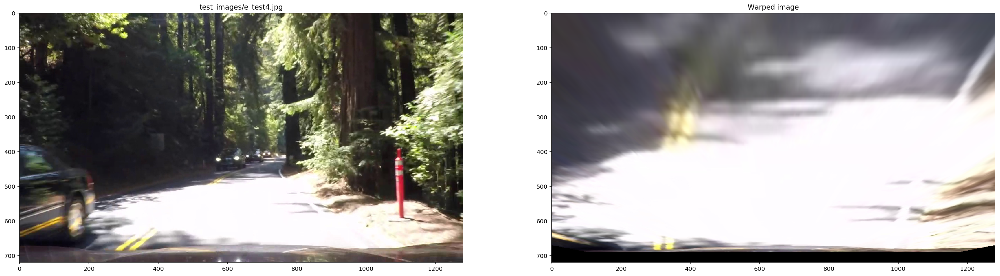

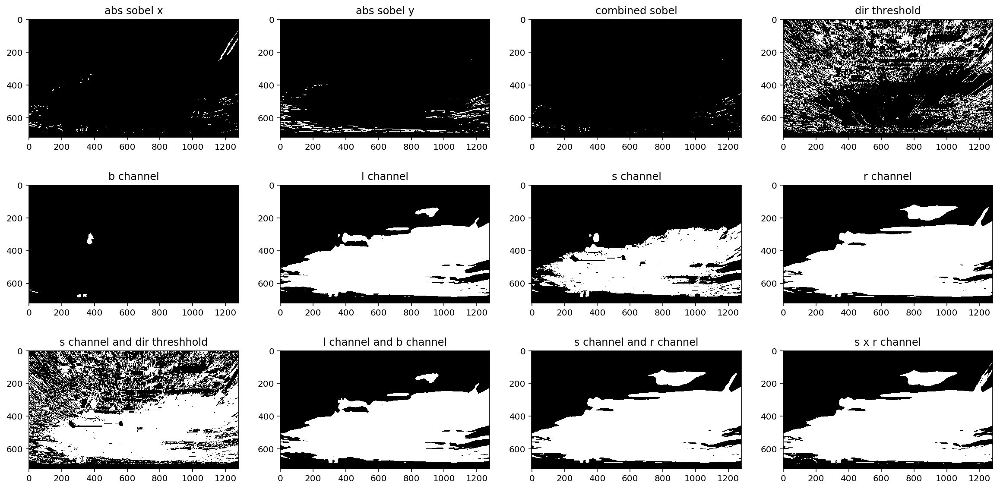

In [62]:
def change(image, a, b):
    mean = np.mean(image)
    image = image - mean
    image = image*a + mean*b
#     image = image/255
    image[image < 0] = 0
    image[image > 255] = 255
    return image

for image in ['test_images/e_test4.jpg']:
    test_img = cv2.imread(image)
    test_img = cv2.cvtColor(test_img, cv2.COLOR_BGR2RGB)
#     a = 2.0
#     b = 0.3
#     test_img[:, :, 0] = change(test_img[:, :, 0], a, b)
#     test_img[:, :, 1] = change(test_img[:, :, 1], a, b)
#     test_img[:, :, 2] = change(test_img[:, :, 2], a, b)
    
    warped_img = pipline.warpperspectiv_img(test_img)
    plt_test_image(test_img, warped_img, image)

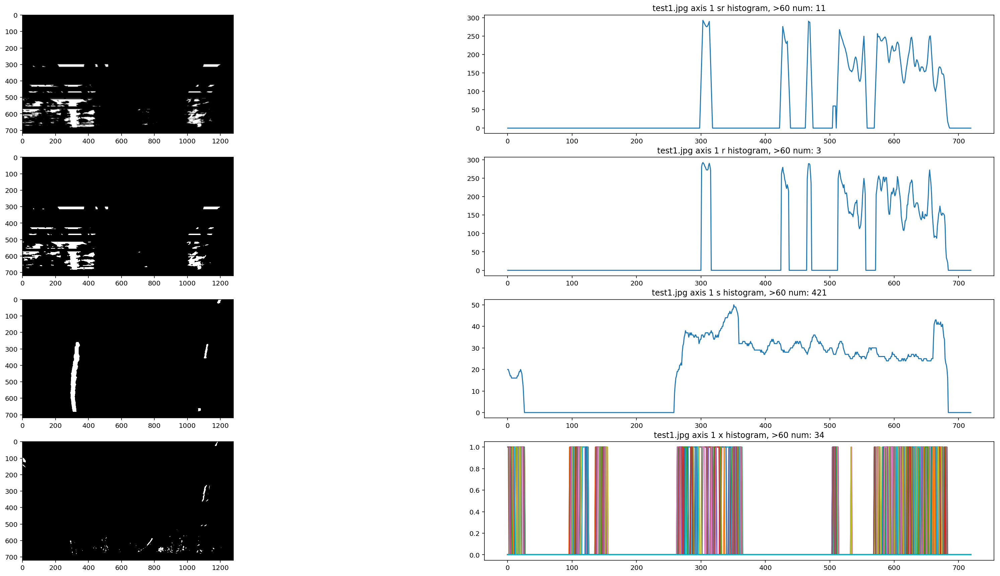

In [66]:
x_thresh = (15, 100)
r_thresh = (190, 255)
s_thresh = (190, 255)

def _remove_noise(binary):
    h, w = 720, 1280
    batch_size_h = 90
    for i in range(0, h, batch_size_h):
        start = i
        end = start + batch_size_h
        histogram = np.sum(binary[start:end, :], axis=1)
        binary[start:end, :][histogram > 300, :] = 0
    return cv2.blur(binary, (5, 5))

img_thresh = ImageThresh()
def show_hist(img_file):
    file_name = img_file.split('/')[-1]
    test_img = cv2.imread(img_file)
    test_img = cv2.cvtColor(test_img, cv2.COLOR_BGR2RGB)
    warped_img = pipline.warpperspectiv_img(test_img)
    sr_channel = img_thresh.s_r_threshshold(warped_img)
    sr_channel = _remove_noise(sr_channel)
    sr_histogram = np.sum(sr_channel, axis=1)
    r_channel = img_thresh.r_threshhold(warped_img)
    r_channel = _remove_noise(r_channel)
    r_histogram = np.sum(r_channel, axis=1)
    s_channel = img_thresh.s_threshhold(warped_img)
    s_channel = _remove_noise(s_channel)
    s_histogram = np.sum(s_channel, axis=1)
    x_sobel = img_thresh.abs_sobel_thresh(warped_img, 'x')
    x_sobel = _remove_noise(x_sobel)
    x_histogram = np.sum(x_sobel, axis=1)
    
    f, ax = plt.subplots(4, 2, figsize=(30,15))
    ax[0][0].imshow(sr_channel, cmap='gray')
    ax[0][1].plot(sr_histogram)
    ax[0][1].set_title('{} axis 1 sr histogram, >60 num: {}'.format(file_name, len(sr_histogram[(sr_histogram<=60)&(sr_histogram>=20)])))
    ax[1][0].imshow(r_channel, cmap='gray')
    ax[1][1].plot(r_histogram)
    ax[1][1].set_title('{} axis 1 r histogram, >60 num: {}'.format(file_name, len(r_histogram[(r_histogram<=60)&(r_histogram>=20)])))
    ax[2][0].imshow(s_channel, cmap='gray')
    ax[2][1].plot(s_histogram)
    ax[2][1].set_title('{} axis 1 s histogram, >60 num: {}'.format(file_name, len(s_histogram[(s_histogram<=60)&(s_histogram>=20)])))
    ax[3][0].imshow(x_sobel, cmap='gray')
    ax[3][1].plot(x_sobel)
    ax[3][1].set_title('{} axis 1 x histogram, >60 num: {}'.format(file_name, len(x_histogram[(x_histogram<=60)&(x_histogram>=20)])))  
    plt.show()

# show_hist('e_test3.jpg')
# show_hist('not_found_line.jpg')
show_hist('test_images/test1.jpg')
# show_hist('test_images/test4.jpg')
# show_hist('test_images/test5.jpg')
# show_hist('test_images/straight_lines2.jpg')

### Test auto choice

/Users/brilliantliu/anaconda/envs/carnd-term1/lib/python3.5/site-packages/matplotlib/pyplot.py:528: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


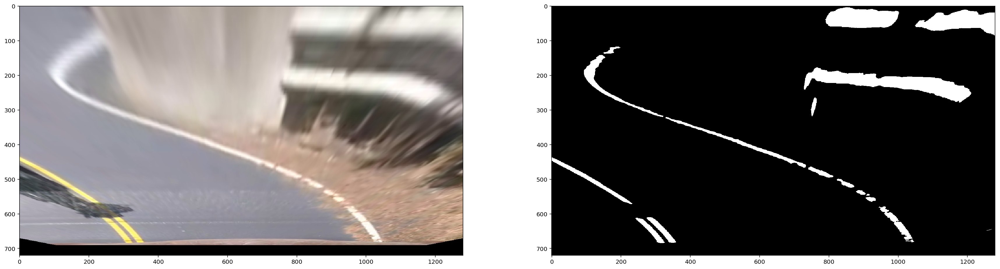

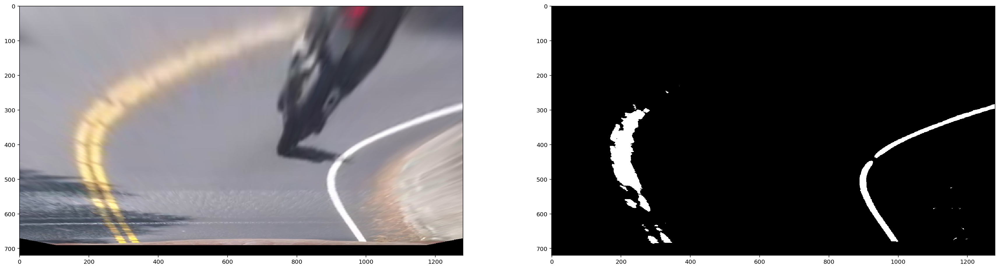

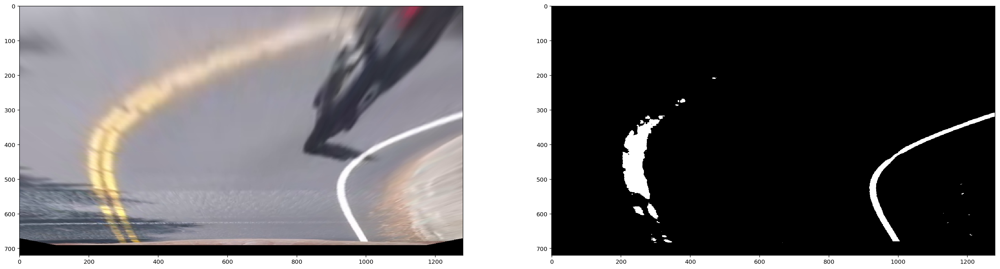

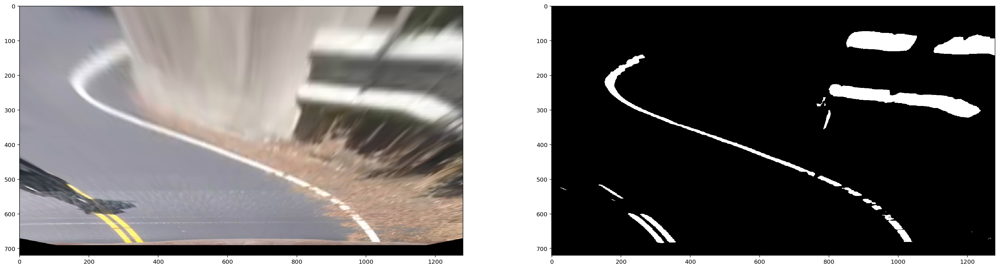

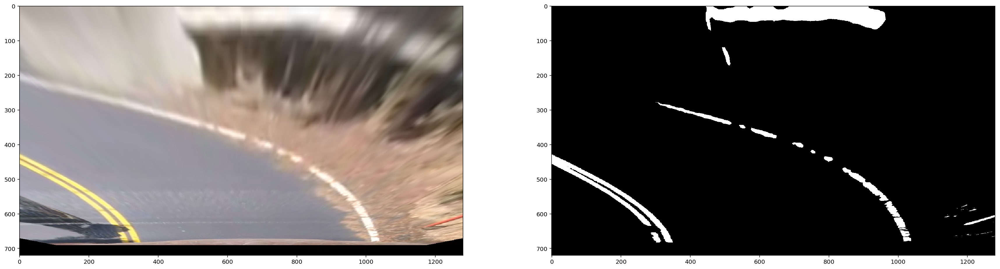

...

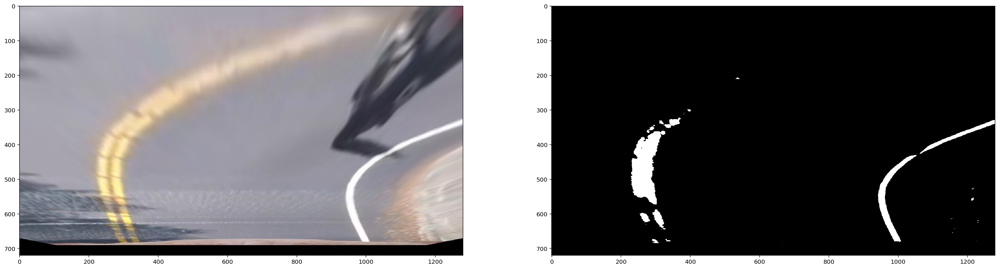

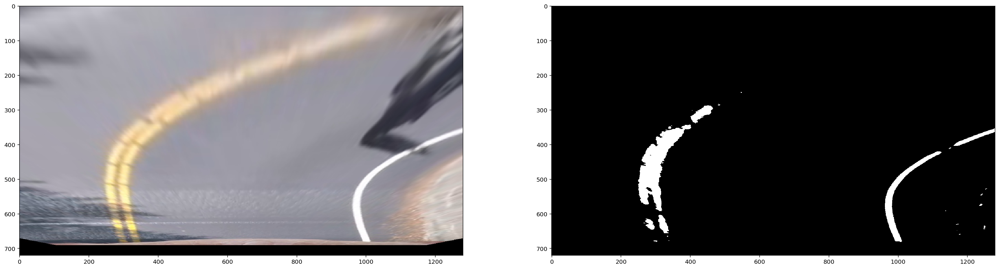

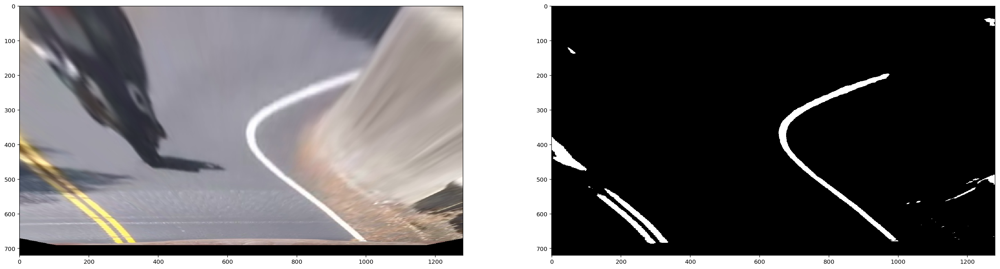

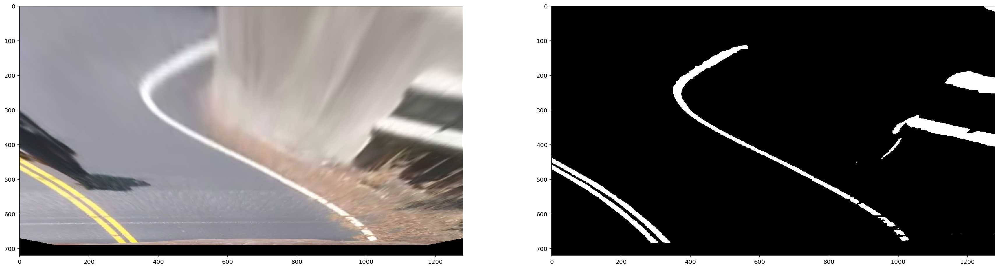

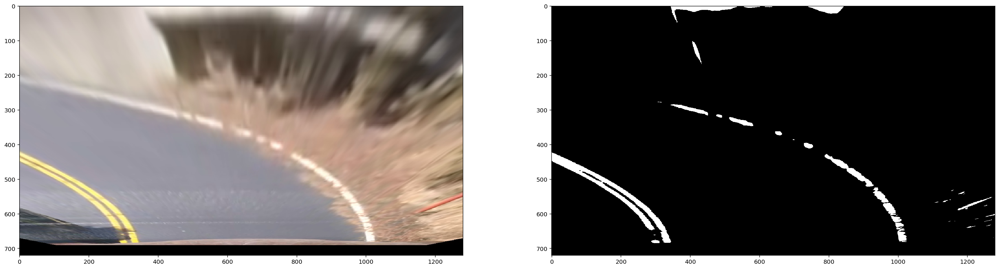

In [23]:
for image in glob.glob('output_images/*.jpg'):
# for image in ['not_found_line.jpg']:
    warped_img = cv2.imread(image)
#     test_img = cv2.cvtColor(test_img, cv2.COLOR_BGR2RGB)
#     warped_img = pipline.warpperspectiv_img(test_img)
    binary_image = img_thresh.l_b_threshhold(warped_img)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(30, 15))
    ax1.imshow(warped_img)
    ax2.imshow(binary_image, cmap='gray')

In [68]:
class Line():
    def __init__(self):
        # was the line detected in the last iteration?
        self.detected = False
        # x values of the last n fits of the line
        self.recent_xfitted = []
        # average x values of the fitted line over the last n iterations
        self.bestx = None
        # polynomial coefficients averaged over the last n iterations
        self.best_fit = None
        # polynomial coefficients for the most recent fit
        self.current_fit = []
        # radius of curvature of the line in some units
        self.radius_of_curvature = None
        self.fit_cr = None
        # distance in meters of vehicle center from the line
        self.line_base_pos = None
        # difference in fit coefficients between last and new fits
        self.diffs = np.array([0, 0, 0], dtype='float')
        # number of detected pixels
        self.px_count = None

    def add(self, fit, inds):
        # add a found fit to the line, up to n
        if fit is not None:
            if self.best_fit is not None:
                # if we have a best fit, see how this new fit compares
                self.diffs = abs(fit - self.best_fit)
            if (self.diffs[0] > 0.001 or self.diffs[1] > 1.0 or self.diffs[2] > 100.) and len(self.current_fit) > 0:
                # bad fit
                self.detected = False
                raise ValueError('not fit', self.diffs)
            else:
                self.detected = True
            self.px_count = np.count_nonzero(inds)
            self.current_fit.append(fit)
            self.recent_xfitted.append(inds)
            if len(self.current_fit) > 5:
                # throw out old fits, keep newest n
                self.current_fit = self.current_fit[-5:]
                self.recent_xfitted = self.recent_xfitted[-5:]
            # self.best_fit = np.average(self.current_fit, axis=0)
            if not self.detected and len(self.current_fit) > 0:
                self.best_fit = np.average(self.current_fit, axis=0)
            else:
                self.best_fit = fit
        # or remove one from the history, if not found
        else:
            self.detected = False
            if len(self.current_fit) > 0:
                # throw out oldest fit
                self.current_fit = self.current_fit[:-1]
                self.recent_xfitted = self.recent_xfitted[:-1]
            if len(self.current_fit) > 0:
                # if there are still any fits in the queue, best_fit is their average
                self.best_fit = np.average(self.current_fit, axis=0)

In [69]:
class PreProcess(object):
    def __init__(self, image_thresh, minv, fun_name_list):
        """
        PreProcess line, find the lines and draw picture
        """
        self.image_thresh = image_thresh
        self.Minv = minv
        self.l_line = Line()
        self.r_line = Line()
        self.i = 0
        self.fun_names = fun_name_list

        self.ym_per_pix = 30 / 720  # meters per pixel in y dimension
        self.xm_per_pix = 3.7 / 700  # meters per pixel in x dimension

    @staticmethod
    def find_base(binary_image):
        # Take a histogram of the bottom half of the image
        histogram = np.sum(binary_image[binary_image.shape[0] // 2:, :], axis=0)
        # Find the peak of the left and right halves of the histogram
        # These will be the starting point for the left and right lines
        midpoint = np.int(histogram.shape[0] // 2)
        leftx_base = np.argmax(histogram[:midpoint])
        rightx_base = np.argmax(histogram[midpoint:]) + midpoint
        return leftx_base, rightx_base

    def get_binary_image(self, warped_img, fun_name):
        """
        type is the image_thresh function's name
        """
        return getattr(self.image_thresh, fun_name)(warped_img)

    def sliding_windows(self, binary_image, nwindows=9, margin=100, minpix=50):
        """
        Fit a second order polynomial to each
        """
        # Set height of windows
        window_height = np.int(binary_image.shape[0] / nwindows)
        # Identify the x and y positions of all nonzero pixels in the image
        nonzero = binary_image.nonzero()
        nonzeroy = np.array(nonzero[0])
        nonzerox = np.array(nonzero[1])
        # Current positions to be update for each window
        leftx_current, rightx_current = self.find_base(binary_image)
        # Create empty lists to receive left and right lane pixel indices
        left_lane_inds = []
        right_lane_inds = []

        # Step through the windows one by one
        for window in range(nwindows):
            # Identify window boundaries in x and y (and right and left)
            win_y_low = binary_image.shape[0] - (window + 1) * window_height
            win_y_high = binary_image.shape[0] - window * window_height
            win_xleft_low = leftx_current - margin
            win_xleft_high = leftx_current + margin
            win_xright_low = rightx_current - margin
            win_xright_high = rightx_current + margin
            # Identify the nonzero pixels in x and y within the window
            good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) &
                              (nonzerox < win_xleft_high)).nonzero()[0]
            good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) &
                               (nonzerox < win_xright_high)).nonzero()[0]
            # Append these indices to the lists
            left_lane_inds.append(good_left_inds)
            right_lane_inds.append(good_right_inds)
            # If you found > minpix pixels, recenter next window on their mean position
            if len(good_left_inds) > minpix:
                leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
            if len(good_right_inds) > minpix:
                rightx_current = np.int(np.mean(nonzerox[good_right_inds]))
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)

        # Extract left and right line pixel positions
        leftx = nonzerox[left_lane_inds]
        lefty = nonzeroy[left_lane_inds]
        rightx = nonzerox[right_lane_inds]
        righty = nonzeroy[right_lane_inds]

        # Fit a second order polynomial to each
        left_fit = np.polyfit(lefty, leftx, 2)
        right_fit = np.polyfit(righty, rightx, 2)

        # Fit new polynomials to x,y in world space
        left_fit_cr = np.polyfit(lefty * self.ym_per_pix, leftx * self.xm_per_pix, 2)
        right_fit_cr = np.polyfit(righty * self.ym_per_pix, rightx * self.xm_per_pix, 2)

        return locals()

    def skip_sliding_windows(self, binary_image, margin=100):
        """
        Skip the sliding windows step once you know where the lines are
        """
        nonzero = binary_image.nonzero()
        nonzeroy = np.array(nonzero[0])
        nonzerox = np.array(nonzero[1])

        left_fit_x = self.l_line.best_fit[0] * (nonzeroy ** 2) + self.l_line.best_fit[1] * nonzeroy + \
                     self.l_line.best_fit[2]
        right_fit_x = self.r_line.best_fit[0] * (nonzeroy ** 2) + self.r_line.best_fit[1] * nonzeroy + \
                      self.r_line.best_fit[2]

        left_lane_inds = ((nonzerox > left_fit_x - margin) & (nonzerox < left_fit_x + margin))
        right_lane_inds = ((nonzerox > right_fit_x - margin) & (nonzerox < right_fit_x + margin))

        leftx = nonzerox[left_lane_inds]
        lefty = nonzeroy[left_lane_inds]
        rightx = nonzerox[right_lane_inds]
        righty = nonzeroy[right_lane_inds]
        # Fit a second order polynomial to each Again
        left_fit = np.polyfit(lefty, leftx, 2)
        right_fit = np.polyfit(righty, rightx, 2)

        left_fit_cr = np.polyfit(lefty * self.ym_per_pix, leftx * self.xm_per_pix, 2)
        right_fit_cr = np.polyfit(righty * self.ym_per_pix, rightx * self.xm_per_pix, 2)

        return locals()

    def add_to_line(self, warped_img, fun_name, margin=100):
        try:
            self.binary_image = self.get_binary_image(warped_img, fun_name)
            if not self.l_line.detected or not self.r_line.detected:
                line_info = self.sliding_windows(self.binary_image, margin=margin)
            else:
                line_info = self.skip_sliding_windows(self.binary_image, margin=margin)

            left_fit = line_info.get('left_fit')
            right_fit = line_info.get('right_fit')
            left_lane_inds = line_info.get('left_lane_inds')
            right_lane_inds = line_info.get('right_lane_inds')
            left_fit_cr = line_info.get('left_fit_cr')
            right_fit_cr = line_info.get('right_fit_cr')

            if left_fit is None or right_fit is None:
                return False, ValueError('not found fit ...')
            self.l_line.add(left_fit, left_lane_inds)
            self.r_line.add(right_fit, right_lane_inds)

            self.l_line.fit_cr = left_fit_cr
            self.r_line.fit_cr = right_fit_cr
            return True, None
        except Exception as ex:
            # print(ex.args)
            return False, ex

    def calc_curv_rad_and_center_dist(self, warped_img, margin=100):
        """
        Method to determine radius of curvature and distance from lane center
        """
        for fun_name in self.fun_names:
            result, ex = self.add_to_line(warped_img, fun_name, margin=margin)
            if result:
                break
        else:
#             print('notfound fun is: ', ex.args)
#             cv2.imwrite('output_images/test_{}.jpg'.format(self.i), self.binary_image)
#             self.i += 1
            self.l_line.current_fit = []
            self.r_line.current_fit = []
            # raise ex

        l_best_fit = self.l_line.best_fit
        r_best_fit = self.r_line.best_fit
        left_fit_cr = self.l_line.fit_cr
        right_fit_cr = self.r_line.fit_cr
        ploty = np.linspace(0, self.binary_image.shape[0] - 1, self.binary_image.shape[0])
        left_fitx = l_best_fit[0] * ploty ** 2 + l_best_fit[1] * ploty + l_best_fit[2]
        right_fitx = r_best_fit[0] * ploty ** 2 + r_best_fit[1] * ploty + r_best_fit[2]

        # Calculate the new radii of curvature
        y_eval = np.max(ploty)
        left_curverad = (
                                (1 + (2 * left_fit_cr[0] * y_eval * self.ym_per_pix + left_fit_cr[1]) ** 2) ** 1.5
                        ) / np.absolute(2 * left_fit_cr[0])
        right_curverad = (
                                 (1 + (2 * right_fit_cr[0] * y_eval * self.ym_per_pix + right_fit_cr[1]) ** 2) ** 1.5
                         ) / np.absolute(2 * right_fit_cr[0])
        # Now our radius of curvature is in meters
        self.l_line.radius_of_curvature = (left_curverad + right_curverad) / 2
        self.r_line.radius_of_curvature = (left_curverad + right_curverad) / 2

        # Calculating the distance between the vehicle distance and the center of the road， > 0 is right else left
        pix_center = self.binary_image.shape[1] / 2 - (left_fitx[-1] + right_fitx[-1]) / 2
        m_center = pix_center * self.xm_per_pix

        self.l_line.line_base_pos = m_center
        self.r_line.line_base_pos = m_center

    def draw_lane(self, src_image):
        new_img = np.copy(src_image)
        l_fit = self.l_line.best_fit
        r_fit = self.r_line.best_fit

        if l_fit is None or r_fit is None:
            return src_image
        h, w = src_image.shape[0], src_image.shape[1]
        # Create an image to draw the lines on
        warp_zero = np.zeros((h, w), dtype=np.uint8)
        color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

        ploty = np.linspace(0, h - 1, num=h)  # to cover same y-range as image
        left_fitx = l_fit[0] * ploty ** 2 + l_fit[1] * ploty + l_fit[2]
        right_fitx = r_fit[0] * ploty ** 2 + r_fit[1] * ploty + r_fit[2]

        # Recast the x and y points into usable format for cv2.fillPoly()
        pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
        pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
        pts = np.hstack((pts_left, pts_right))

        # Draw the lane onto the warped blank image
        cv2.fillPoly(color_warp, np.int_([pts]), (0, 180, 0))
        cv2.polylines(color_warp, np.int32([pts_left]), isClosed=False, color=(255, 0, 0), thickness=15)
        cv2.polylines(color_warp, np.int32([pts_right]), isClosed=False, color=(0, 0, 255), thickness=15)

        # Warp the blank back to original image space using inverse perspective matrix (Minv)
        newwarp = cv2.warpPerspective(color_warp, self.Minv, (w, h))
        # Combine the result with the original image
        result = cv2.addWeighted(new_img, 1, newwarp, 1, 0)
        return result

    def draw_small(self, src_image, warped_img):
        small_shape = (640, 300)
        small_binary = cv2.resize(self.binary_image, small_shape)
        small_binary_image = np.dstack((small_binary, small_binary, small_binary)) * 255
        small_warp_image = cv2.resize(warped_img, small_shape)
        hmerge = np.hstack((small_warp_image, small_binary_image))
        background = self.draw_lane(src_image)
        background[:300, :, :] = hmerge * 0.8
        return background

    def draw_data(self, src_image, warped_img):
        self.calc_curv_rad_and_center_dist(warped_img)
        new_img = np.copy(self.draw_small(src_image, warped_img))
        font = cv2.FONT_HERSHEY_DUPLEX
        text = 'Curve radius: ' + '{:04.2f}.'.format(self.l_line.radius_of_curvature) + 'm'
        cv2.putText(new_img, text, (40, 350), font, 1.5, (255, 255, 255), 2, cv2.LINE_AA)
        if self.l_line.line_base_pos > 0:
            direction = 'right'
        else:
            direction = 'left'
        abs_center_dist = abs(self.l_line.line_base_pos)
        text = direction + ' of center ' + '{:04.3f}'.format(abs_center_dist) + 'm'
        cv2.putText(new_img, text, (40, 400), font, 1.5, (255, 255, 255), 2, cv2.LINE_AA)
        return new_img

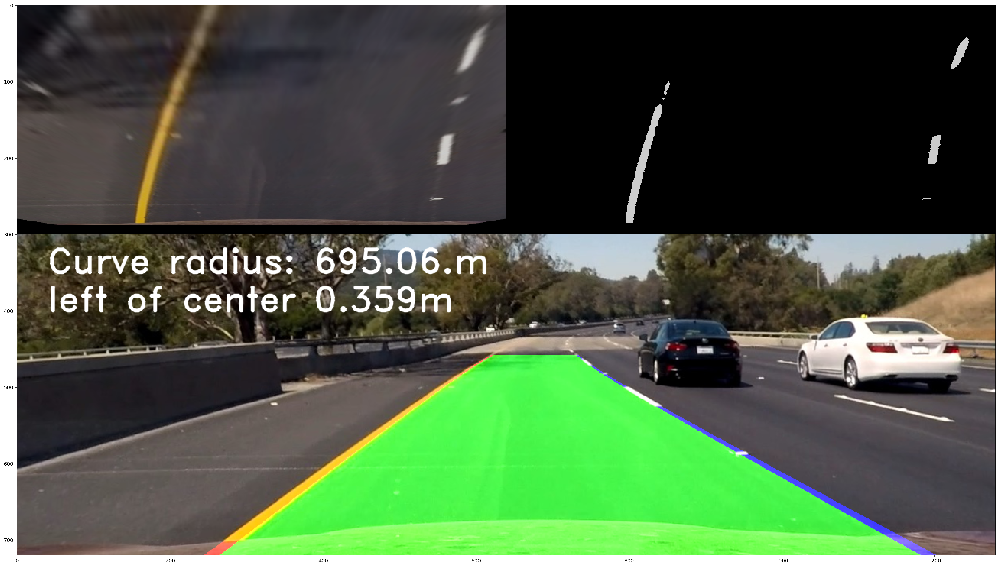

In [96]:
pipline = PipleLine(camera_wide_dist_file)
img_thresh = ImageThresh(r_thresh=(210, 255))
fun_names = ['r_threshhold','s_r_threshshold', 's_threshhold']
pre = PreProcess(img_thresh, pipline.Minv, fun_names)

test_draw_lane_image = 'test_images/test6.jpg'
image = mpimg.imread(test_draw_lane_image)
undis_image = pipline.undistort_img(image)
warped_image = pipline.warpperspectiv_img(image)
result1 = pre.draw_data(undis_image, warped_image)
plt.figure(figsize=(40, 20))
plt.imshow(result1)
plt.show()

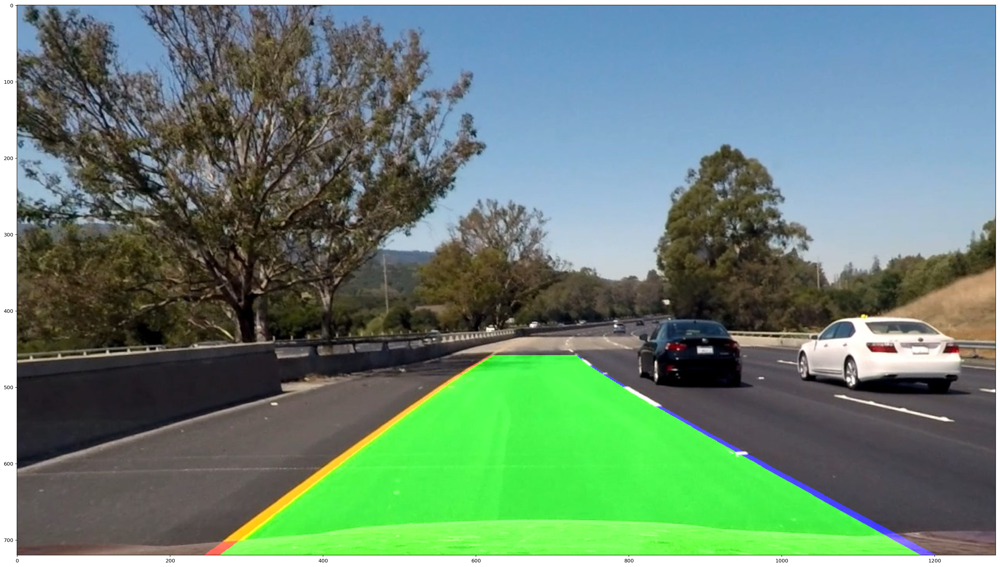

In [98]:
result = pre.draw_lane(undis_image)
plt.figure(figsize=(40, 20))
plt.imshow(result)
plt.show()

## Process Project Video

In [70]:
pipline = PipleLine(camera_wide_dist_file)
img_thresh = ImageThresh(r_thresh=(210, 255))
fun_names = ['r_threshhold','s_r_threshshold', 's_threshhold']
pre = PreProcess(img_thresh, pipline.Minv, fun_names)

def process_image(image):
    undis_image = pipline.undistort_img(image)
    warped_image = pipline.warpperspectiv_img(image)
    result = pre.draw_data(undis_image, warped_image)
    return result

In [71]:
from moviepy.editor import VideoFileClip
from IPython.display import HTML

In [72]:
project_output = 'project_video_output.mp4'
clip1 = VideoFileClip("project_video.mp4")
project_clip = clip1.fl_image(process_image)
%time project_clip.write_videofile(project_output, audio=False)

[MoviePy] >>>> Building video project_video_output.mp4
[MoviePy] Writing video project_video_output.mp4



100%|█████████▉| 1260/1261 [01:36<00:00, 13.12it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video_output.mp4 

CPU times: user 2min 7s, sys: 10.2 s, total: 2min 17s
Wall time: 1min 37s


In [73]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(project_output))

In [74]:
pipline = PipleLine(camera_wide_dist_file)
img_thresh = ImageThresh(r_thresh=(170, 255))
fun_names = ['s_r_threshhold', 's_threshhold', 'r_threshhold']
pre = PreProcess(img_thresh, pipline.Minv, fun_names)

challenge_output_name = 'challenge_video_output.mp4'
clip2 = VideoFileClip("challenge_video.mp4")
challenge_clip = clip2.fl_image(process_image)
%time challenge_clip.write_videofile(challenge_output_name, audio=False)

[MoviePy] >>>> Building video challenge_video_output.mp4
[MoviePy] Writing video challenge_video_output.mp4


100%|██████████| 485/485 [00:40<00:00, 11.96it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: challenge_video_output.mp4 

CPU times: user 55.5 s, sys: 3.03 s, total: 58.5 s
Wall time: 41.2 s


In [75]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(challenge_output_name))

In [78]:
img_thresh = ImageThresh(r_thresh=(200, 255))
fun_names = ['r_threshhold', 's_threshhold', 's_r_threshshold']
pre = PreProcess(img_thresh, pipline.Minv, fun_names)

harder_challenge_output_name = 'harder_challenge_video_output.mp4'
clip2 = VideoFileClip("harder_challenge_video.mp4")
harder_challenge_clip = clip2.fl_image(process_image)
%time harder_challenge_clip.write_videofile(harder_challenge_output_name, audio=False)

[MoviePy] >>>> Building video harder_challenge_video_output.mp4
[MoviePy] Writing video harder_challenge_video_output.mp4


100%|█████████▉| 1199/1200 [02:21<00:00,  8.49it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: harder_challenge_video_output.mp4 

CPU times: user 2min 47s, sys: 20.8 s, total: 3min 8s
Wall time: 2min 21s


In [79]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(harder_challenge_output_name))